# MTH3302 : Méthodes probabilistes et statistiques pour l'I.A.

Jonathan Jalbert<br/>
Professeur agrégé au Département de mathématiques et de génie industriel<br/>
Polytechnique Montréal<br/>

# Projet A2021 : Prédire les maladies cardiaques

La description du projet est disponible à l'adresse suivante :
https://www.kaggle.com/t/3a185493d8bb48d8961ad50e465bed4f

Ce calepin Jupyter de base permet de 

1. Charger les données fournies.
2. Effectuer une analyse exploratoire sommaire des données.
3. Développer un modèle simple de prédiction.
4. Générer le fichier de prédictions à téléverser sur Kaggle.

Dans un premier temps, vous devrez récupérer les données sous l'onglet *data* du site Kaggle. Il y a deux fichiers :
- train.csv
- test.csv

Le fichier *train.csv* contient les données sur lesquelles vous pouvez entraîner votre modèle. Il sera ensuite évaluée sur les données de l'ensemble *test.csv* lorsque vous aurez téléversé vos prédictions sur Kaggle. 

### Consignes

- Vous devez constituer une équipe de 3 à 5 personnes.
- Au moins une solution doit être proposée sur Kaggle.
- Utilisez votre numéro d'équipe pour téléverser vos prédictions sur Kaggle.
- Un seul fichier .ipynb par équipe faisant office de rapport et permettant de reproduire vos meilleures prédictions doit être remis.
- Le langage Julia doit être utilisé.
- Votre démarche doit être rigoureusement justifiée (consultez la grille de correction pour vous orienter).

### Quelques conseils

Votre calepin doit permettre de suivre clairement votre raisonnement et de reproduire vos résultats. Garder à l'esprit que vos résultats et votre démarche doivent être reproductibles par une personne à l'extérieur de votre équipe. Le calepin constitue le rapport. Servez vous des cellules de texte pour décrire ce que vous faites.

Je vous encourage fortement à faire une analyse exploratoire de vous données pour développer une meilleure expertise du problème. C'est une étape qui est toujours négligée par les débutants mais qui est essentielle. C'est avec l'analyse exploratoire que vous viendra des idées d'amélioration, par exemple créer de nouvelles variables explicatives.

Vous pouvez utiliser directement tout ce qui se retrouve dans les notes de cours sans explication et toutes les librairies utilisées dans le cours (incluant mes fonctions).

Ce calepin de base contient un modèle très simple de prédiction : on prédit 0 débordement à tous les jours. Ce sera votre travail d'améliorer ces prédictions naïves avec la méthode de votre choix.

Il faudra que vous trouviez un moyen de traiter les données manquantes. La plupart du temps, une méthode simple d'imputation (de remplacement) des données manquantes est appropriée.

Prenez la peine de tout documenter, même les essais infructueux. Ce n'est pas nécessaire de les expliquer en détails, mais c'est important de les mentionner au moins succintement dans la discussion avec une raison possible pour leur échec. De cette façon, une personne qui reprendra votre travail dans le futur ne perdra pas de temps à réessayer une méthode déjà implémentée et infructueuse.

Vous pouvez aussi indiquer dans votre rapport les raisons qui vous font croire pourquoi une méthode à moins bien performée que ce à quoi vous vous attendiez. Vous pouvez également mentionner ce que vous auriez pu tenter si vous aviez eu plus de temps ou plus de données, etc. L'idée est de guider le prochain scientifique qui prendra la relève de votre travail.

Vous êtes limités à deux soumissions par jour par équipe sur Kaggle. Je vous suggère donc de bien tester vos modèles localement et de ne téléverser que vos meilleurs candidats.

In [295]:
ENV["COLUMNS"] = 150
using CSV, DataFrames, Gadfly, GLM, Statistics, LinearAlgebra, Distributions, Combinatorics, StatsBase, MLBase, Random
include("functions.jl");

### 1. Chargement des données

In [296]:
data = CSV.read("train.csv", DataFrame)
first(data,5)

,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String1,String3,Int64,Int64⍰,Int64,String7,Int64,String1,Float64,String7,Int64
1,1,69,M,ASY,140,110,1,Normal,109,Y,1.5,Flat,1
2,2,60,M,ASY,140,293,0,LVH,170,N,1.2,Flat,1
3,3,52,M,ASY,165,missing,1,Normal,122,Y,1.0,Up,1
4,4,46,M,NAP,120,230,0,Normal,150,N,0.0,Up,0
5,5,61,M,NAP,120,missing,0,Normal,80,Y,0.0,Flat,1


## 2. Analyse exploratoire

#### En premier lieu, nous allons visualiser le l'échantillon d'entrainement que nous avons à l'aide des graphiques.

Avant d'afficher des graphiques, nous avons jetté un coup d'oeil sur les données du projet.
Voici les variables explicatives de nos données et leurs valeurs possibles:


#### Variables explicatives:
- **Age** Valeurs: Ensemble des entiers positives

- **Sex** Valeurs qualitatives possibles: *M, F*

- **ChestPainType** Valeurs qualitatives possibles: *ASY, NAP, ATA, TA*

- **RestingBP** Valeurs: Ensemble des entiers positives

- **Cholesterol** Valeurs: Ensemble des entiers positives

- **FastingBS** Valeurs: Ensemble des entiers positives

- **RestingECG** Valeurs qualitatives possibles: *Normal, LVH, ST*

- **MaxHR** Valeurs: Ensemble des entiers positives

- **ExerciseAngina** Valeurs qualitatives possibles: *Y, N*

- **Oldpeak** Valeurs: Ensemble réelles

- **STSlope** Valeurs qualitatives possibles: *Flat, Up, Down*


La variable à estimer est **HeartDisease** qui prend les valeurs *0, 1*.

#### 2.1 HeartDisease en fonction des variables explicatives.

In [297]:
plots = Plot[]
properties = propertynames(data[!, Not([:ID, :HeartDisease])])
for property in properties
    push!(
        plots,
        plot(
            data, 
            x=property, 
            y=:HeartDisease,
            color=[colorant"gold"],
            Guide.title("HeartDisease en fonction de $property")
            )
    )
end
Gadfly.set_default_plot_size(20cm, 80cm)
vstack(plots)

Compose.Context(Measures.BoundingBox{Tuple{Measures.Length{:cx, Int64}, Measures.Length{:cy, Int64}}, Tuple{Measures.Length{:w, Float64}, Measures.Length{:h, Float64}}}((0cx, 0cy), (1.0w, 1.0h)), nothing, nothing, nothing, nothing, List([Compose.Context(Measures.BoundingBox{Tuple{Measures.Length{:w, Float64}, Measures.Length{:h, Float64}}, Tuple{Measures.Length{:w, Float64}, Measures.Length{:h, Float64}}}((0.0w, 0.9090909090909093h), (1.0w, 0.09090909090909091h)), nothing, nothing, nothing, nothing, List([Compose.Context(Measures.BoundingBox{Tuple{Measures.AbsoluteLength, Measures.AbsoluteLength}, Tuple{Measures.Add{Measures.Add{Measures.Length{:w, Float64}, Measures.AbsoluteLength}, Measures.AbsoluteLength}, Measures.Add{Measures.Add{Measures.Length{:h, Float64}, Measures.AbsoluteLength}, Measures.AbsoluteLength}}}((5.0mm, 5.0mm), (1.0w + -5.0mm + -5.0mm, 1.0h + -5.0mm + -5.0mm)), nothing, nothing, nothing, nothing, List([Compose.Table(Vector{Compose.Context}[[] [] [Compose.Context(Me

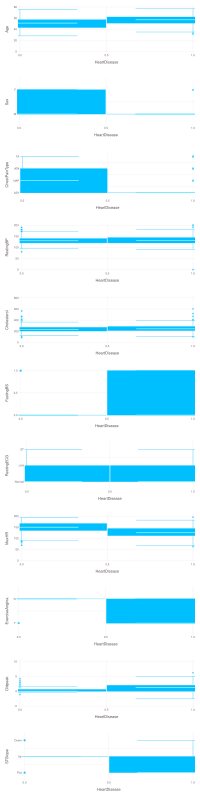

In [298]:
plots = Plot[]

for propertyname in propertynames(data[!, Not([:ID, :HeartDisease])])
    if propertyname == :Cholesterol
        push!(
            plots,
            plot(
                dropmissing(
                    DataFrame(
                        Cholesterol=data.Cholesterol,
                        HeartDisease=data.HeartDisease
                    )),
                x="HeartDisease",
                y="Cholesterol",
                Geom.boxplot,
            )
        )
    else
        push!(
            plots,
            plot(
                data,
                x=:HeartDisease,
                y=propertyname,
                Geom.boxplot,
            )
        )
    end
end


vstack(plots)

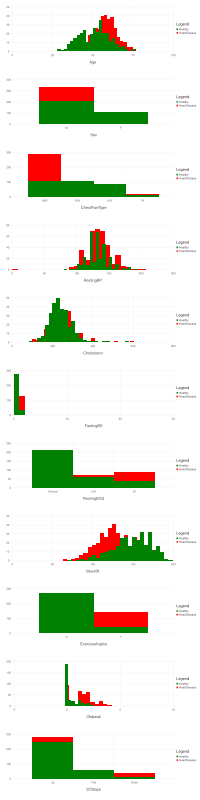

In [299]:
plots = Plot[]
for propertyname in propertynames(data[!, Not([:ID, :HeartDisease])])
    push!(
        plots,
        plot(
            [layer(
                filter(row -> row.HeartDisease == i, data),
                x=propertyname,
                Geom.histogram(bincount=floor(sqrt(nrow(data)))),
                Theme(default_color=i == 0 ? "green" : "red", alphas=[0.5]),
            ) for i = 0:1]...,
            Guide.xlabel(string(propertyname)),
            Guide.manual_color_key("Legend", ["Healthy", "HeartDisease"], ["green", "red"]),
        )
    )
end
vstack(plots)

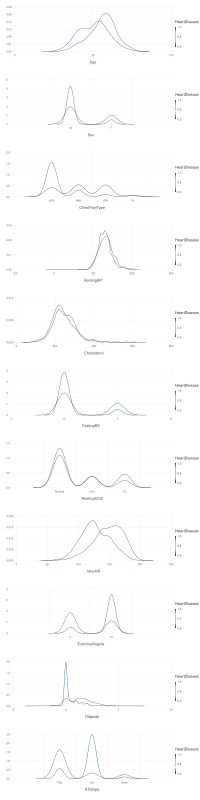

In [300]:
plots = Plot[]

for propertyname in propertynames(data[!, Not([:ID, :HeartDisease])])
    if propertyname == :Cholesterol
        push!(
            plots,
            plot(
                dropmissing(
                    DataFrame(
                        Cholesterol=data.Cholesterol,
                        HeartDisease=data.HeartDisease
                    )),
                x=:Cholesterol,
                color=:HeartDisease,
                Geom.density,
                Guide.xlabel("Cholesterol"),
                Guide.colorkey(title="HeartDisease"),
            )
        )
    else
    push!(
        plots,
        plot(
            data,
            x=propertyname,
            color=:HeartDisease,
            Geom.density,
            Guide.xlabel(string(propertyname)),
            Guide.colorkey(title="HeartDisease"),
        )
    )
    end
end



vstack(plots)

### 3 Préparation des données

In [301]:
Random.seed!(1998)

ntrain = round(Int, 0.80 * nrow(data))

train_id = sample(1:nrow(data), ntrain, replace=false, ordered=true)
valid_id = setdiff(1:nrow(data), train_id)

train = data[train_id, :]
valid = data[valid_id, :]

first(train, 5)

,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String1,String3,Int64,Int64⍰,Int64,String7,Int64,String1,Float64,String7,Int64
1,1,69,M,ASY,140,110,1,Normal,109,Y,1.5,Flat,1
2,2,60,M,ASY,140,293,0,LVH,170,N,1.2,Flat,1
3,3,52,M,ASY,165,missing,1,Normal,122,Y,1.0,Up,1
4,4,46,M,NAP,120,230,0,Normal,150,N,0.0,Up,0
5,5,61,M,NAP,120,missing,0,Normal,80,Y,0.0,Flat,1


##### **Section 3.1 Fonctions pour traiter les données manquantes**

Dans notre jeu de données, nous avons plusieurs donnée manquantes dans la colonne de Cholesterol.

Nous avons deux solutions concernant ce problème:
1. Enlever les lignes où il y a un *Cholesterol* manquant (*missing*)
2. Remplacer les données manquantes par la moyenne des valeurs de la colonne du *Cholesterol*

In [302]:
nrow(data)

688

In [303]:
chol_colonne = countmap(data.Cholesterol)

Dict{Union{Missing, Int64}, Int64} with 206 entries:
  220 => 9
  308 => 6
  215 => 5
  319 => 1
  185 => 3
  404 => 1
  417 => 1
  365 => 1
  168 => 2
  207 => 5
  263 => 4
  603 => 1
  242 => 1
  518 => 1
  224 => 5
  177 => 5
  264 => 5
  172 => 1
  339 => 2
  280 => 1
  208 => 6
  336 => 1
  211 => 7
  358 => 1
  468 => 1
  ⋮   => ⋮

Nous pouvons voir qu'il y a 123 valeurs manquantes sur un total de 688 valeurs. C'est un nombre très grand, représentant environ **17.8%** des valeurs de Cholesterol.

Si on décide d'enlever les lignes où il y a une valeur de *Cholesterol* manquante, on perdrait aussi 17.8% des exemples des variables explicatives et ceci rendrait notre jeu de données moins diversifié et diminuerait notre capacité de prédir par conséquence.

Pour cette raison, nous avons choisi de remplacer les valeurs de *Cholesterol* manquantes avec la moyenne de la colonne du *Cholesterol*.

In [304]:
# Option 1: Enlever les lignes où il y a une valeur de Cholesterol manquante.
function removeMissingCholesterolRows(dataframe::DataFrame)
    dropmissing!(dataframe)
    println("Toutes les lignes avec une valeur manquante sont retirées")
end

# Option 2: remplacer les valeurs de Cholesterol manquantes avec la moyenne de la colonne du Cholesterol.
function replaceMissingCholesterolMean(dataframe::DataFrame)
    cholesterol_mean = floor(Int, mean(skipmissing(dataframe.Cholesterol)))
    dataframe[!, :Cholesterol] = coalesce.(dataframe.Cholesterol, cholesterol_mean);
    println("Toutes les valeurs manquantes ont été remplancées par la moyenne de la colonne Cholesterol: $cholesterol_mean")
end



replaceMissingCholesterolMean(train)
replaceMissingCholesterolMean(valid)
first(train, 5)


Toutes les valeurs manquantes ont été remplancées par la moyenne de la colonne Cholesterol: 245
Toutes les valeurs manquantes ont été remplancées par la moyenne de la colonne Cholesterol: 242


,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String1,String3,Int64,Int64,Int64,String7,Int64,String1,Float64,String7,Int64
1,1,69,M,ASY,140,110,1,Normal,109,Y,1.5,Flat,1
2,2,60,M,ASY,140,293,0,LVH,170,N,1.2,Flat,1
3,3,52,M,ASY,165,245,1,Normal,122,Y,1.0,Up,1
4,4,46,M,NAP,120,230,0,Normal,150,N,0.0,Up,0
5,5,61,M,NAP,120,245,0,Normal,80,Y,0.0,Flat,1


##### **Section 3.2 Transformation des variables qualitatives**

Ici , on transforme les valeurs qualitatives en valeur quantitatives.
Par exemple pour le *Sexe*, M prendra 1 comme valeur quantitative et F prendra 0.

In [305]:
function transformQualitativeVariables(dataframe::DataFrame)
    n = nrow(dataframe)
    sex = zeros(Int, n)
    for i in 1:n
        if (dataframe.Sex[i] == "M")
            sex[i] = 1;
        end
    end
    dataframe[!, :Sex] = sex;

    ChestPainType1 = zeros(Int, n)
    ChestPainType2 = zeros(Int, n)
    ChestPainType3 = zeros(Int, n)
    for i in 1:n
        if (dataframe.ChestPainType[i] == "ATA")
            ChestPainType1[i] = 1;
        elseif (dataframe.ChestPainType[i] == "NAP")
            ChestPainType2[i] = 1; 
        elseif (dataframe.ChestPainType[i] == "ASY")
            ChestPainType3[i] = 1;
        end
    end
    select!(dataframe, Not(:ChestPainType))
    dataframe[!, :ChestPainType1] = ChestPainType1;
    dataframe[!, :ChestPainType2] = ChestPainType2;
    dataframe[!, :ChestPainType3] = ChestPainType3;

    # RestingBP
    restingECG1 = zeros(Int, n)
    restingECG2 = zeros(Int, n)

    for i in 1:n
        if (dataframe.RestingECG[i] == "ST")
            restingECG1[i] = 1;
        elseif (dataframe.RestingECG[i] == "LVH")
            restingECG2[i] = 1;  
        end
    end
    select!(dataframe, Not(:RestingECG))
    dataframe[!, :RestingECG1] = restingECG1;
    dataframe[!, :RestingECG2] = restingECG2;


    exerciseAngina = zeros(Int, n)
    for i in 1:n
        if (dataframe.ExerciseAngina[i] == "Y")
            exerciseAngina[i] = 1;
        end
    end
    dataframe[!, :ExerciseAngina] = exerciseAngina;


    STSlope1 = zeros(Int, n)
    STSlope2 = zeros(Int, n)

    for i in 1:n
        if (dataframe.STSlope[i] == "Flat")
            STSlope1[i] = 1;
        elseif (dataframe.STSlope[i] == "Down")
            STSlope2[i] = 1;  
        end
    end
    select!(dataframe, Not(:STSlope))
    dataframe[!, :STSlope1] = STSlope1;
    dataframe[!, :STSlope2] = STSlope2;

end


transformQualitativeVariables (generic function with 1 method)

In [306]:
transformQualitativeVariables(train)
transformQualitativeVariables(valid)
propertynames(select(train, Not([:ID, :HeartDisease])))


15-element Vector{Symbol}:
 :Age
 :Sex
 :RestingBP
 :Cholesterol
 :FastingBS
 :MaxHR
 :ExerciseAngina
 :Oldpeak
 :ChestPainType1
 :ChestPainType2
 :ChestPainType3
 :RestingECG1
 :RestingECG2
 :STSlope1
 :STSlope2

### 4 Fonctions d'entraînement de modèles

##### **Section 4.1 Entraînement du modèle de *régression logistique***

Dans cette section, nous allons trouvez les meilleurs variables explications pour entrainer le modèle pour la régression logistique. Pour ce faire, nous avons utiliser la méthode pas à pas ascendante. Nous avons essayé deux critères différents pour déterminer la variables explicatives a prendre à chaque étape.
La fonction `forwardStepwiseRegressionAUC` utilise l'air sous la courbe ROC alors que la fonction `forwardStepwiseRegressionThreshold` vérifie le ratio du nombre de données bien prédites dans notre ensemble d'entrainement en utilisant la fonction `findBestThreshold`.

In [307]:
function findBestThreshold(df::DataFrame, θ̂ ::Array{Float64})
    maxScore = 0;
    best_threshold = 0;
    for threshold in 0.1:0.01:0.9
        ŷ = Int64[]
        index = 0;
        for θ̂ᵢ in θ̂
            if θ̂ᵢ >= threshold
                push!(ŷ, 1)
            else
                push!(ŷ, 0)
            end
        end
        score = correctrate(df.HeartDisease, ŷ)
        if (score >= maxScore)
            maxScore = score
            best_threshold = threshold
        end
    end
    println("Meilleur score est ", maxScore, " avec ", best_threshold)
    return maxScore
end

findBestThreshold (generic function with 2 methods)

In [308]:
function forwardStepwiseRegressionAUC(data_frame::DataFrame, variables::Array{Symbol})
    current_variables = Array{Symbol}(undef, 0)
    max_area = 0;
    best_formula = undef

    best_current_variable_index = -1;
    best_current_formula = undef
    variable_count = length(variables)

    for i in 1:variable_count
        current_max_area = 0;
        for j in 1:length(variables)
                        
            if (length(current_variables) != 0)
                formula = Term(:HeartDisease) ~ sum(Term(current_variables[k]) for k in 1:length(current_variables)) + Term(variables[j]) 
            else
                formula = Term(:HeartDisease) ~ Term(variables[j])
            end

            M = glm(formula, data_frame,  Bernoulli(), LogitLink())
            θ̂ = Vector{Float64}(predict(M, data_frame))
            area = auc(data_frame.HeartDisease,  θ̂ )
            if (area > current_max_area)
                current_max_area = area
                best_current_variable_index = j
                best_current_formula = formula
            end
            println("AUC pour ", formula, " : ", area)
            
        end
        if (current_max_area > max_area)
            max_area = current_max_area
            best_formula = best_current_formula
            push!(current_variables, variables[best_current_variable_index])
            deleteat!(variables, best_current_variable_index)
        else
            break;
        end
        println("Meilleur variables ", best_formula, " : ", max_area)
        println()
        
    end
    return best_formula
end

forwardStepwiseRegressionAUC (generic function with 1 method)

In [309]:
function forwardStepwiseRegressionThreshold(data_frame::DataFrame, variables::Array{Symbol})
    current_variables = Array{Symbol}(undef, 0)
    max_area = 0;
    best_formula = undef

    best_current_variable_index = -1;
    best_current_formula = undef
    variable_count = length(variables)
    
    for i in 1:variable_count
        current_max_area = 0;
        for j in 1:length(variables)
                        
            if (length(current_variables) != 0)
                formula = Term(:HeartDisease) ~ sum(Term(current_variables[k]) for k in 1:length(current_variables)) + Term(variables[j]) 
            else
                formula = Term(:HeartDisease) ~ Term(variables[j])
            end

            M = glm(formula, data_frame, Bernoulli(), LogitLink())
            θ̂ = convert(Array{Float64}, predict(M, data_frame))
            area = findBestThreshold(data_frame, θ̂ )
            if (area > current_max_area)
                current_max_area = area
                best_current_variable_index = j
                best_current_formula = formula
            end
            println("AUC pour ", formula, " : ", area)
            
            
        end
        if (current_max_area > max_area)
            max_area = current_max_area
            best_formula = best_current_formula
            push!(current_variables, variables[best_current_variable_index])
            deleteat!(variables, best_current_variable_index)
        else
            break;
        end
        println("Meilleur variables ", best_formula, " : ", max_area)
        println()
        
    end
    return best_formula
end

forwardStepwiseRegressionThreshold (generic function with 1 method)

##### **Section 4.2 Entraînement du modèle de *régression logistique avec les composantes principales***

##### **Section 4.3 Entraînement du modèle de *classification bayésienne naïve***

Dans cette section, nous allons entraîner un modèle statistique bayésienne dans le but de faire une classification bayésienne naïve.

Les lois conditionnelles des variables explicatives:
- f(Xi|Yi=0,θ)(xi)
- f(Xi|Yi=1,θ)(xi)

seront modélisés par les distributions que nous avons établi pour un diagnostic donné . On a écrit une fonction nous permettant de visualiser différentes distributions superposées à l'histogramme des variables explicatives des maladies cardiaques (HeartDisease), séparées en fonction d'une caractéristique. Cette fonction prend en paramètre les données qu'on tracera sur l'histogramme ainsi qu'une dictionnaire de distributions.

**Section 4.3.1 Visualisation des distributions des variables aléatoires**

Dans la case ci-dessous, nous avons listé toutes les distributions possibles pour chaque variable aléatoire.

In [310]:
graphs_distributions = Dict(
    :Age => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}, LogNormal{Float64}, Gamma{Float64}],
    :Sex => [Normal{Float64}, Bernoulli{Float64}],
    :RestingBP => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}],
    :Cholesterol => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}, LogNormal{Float64}, Gamma{Float64}],
    :FastingBS => [Normal{Float64}, Bernoulli{Float64}],
    :MaxHR => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}, LogNormal{Float64}, Gamma{Float64}],
    :ExerciseAngina => [Normal{Float64}, Bernoulli{Float64}],
    :Oldpeak => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}],
    :ChestPainType1 => [Normal{Float64}, Bernoulli{Float64}],
    :ChestPainType2 => [Normal{Float64}, Bernoulli{Float64}],
    :ChestPainType3 => [Normal{Float64}, Bernoulli{Float64}],
    :RestingECG1 => [Normal{Float64}, Bernoulli{Float64}],
    :RestingECG2 => [Normal{Float64}, Bernoulli{Float64}],
    :STSlope1 => [Normal{Float64}, Bernoulli{Float64}],
    :STSlope2 => [Normal{Float64}, Bernoulli{Float64}],
)

Dict{Symbol, Vector{DataType}} with 15 entries:
  :STSlope1       => [Normal{Float64}, Bernoulli{Float64}]
  :RestingECG2    => [Normal{Float64}, Bernoulli{Float64}]
  :ChestPainType3 => [Normal{Float64}, Bernoulli{Float64}]
  :Oldpeak        => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}]
  :Sex            => [Normal{Float64}, Bernoulli{Float64}]
  :RestingECG1    => [Normal{Float64}, Bernoulli{Float64}]
  :STSlope2       => [Normal{Float64}, Bernoulli{Float64}]
  :Cholesterol    => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}, LogNormal{Float64}, Gamma{Float64}]
  :ChestPainType1 => [Normal{Float64}, Bernoulli{Float64}]
  :Age            => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}, LogNormal{Float64}, Gamma{Float64}]
  :FastingBS      => [Normal{Float64}, Bernoulli{Float64}]
  :MaxHR          => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}, LogNormal{Float64}, Gamma{Float64}]
  :RestingBP      => [Normal{Float64}, Inver

La fonction ci-dessous permet d'afficher l'histogramme de la variable aléatoire et les différentes distributions superposées. Nous allons faire le choix d'une distribution dans la prochaine section pour entrainer le modèle de classification bayésienne naïve.

In [311]:
function viewVariableDistribution(dataframe::DataFrame, property::Symbol)
    distributionsOfVariable = graphs_distributions[property]

    plots = Plot[]
    colors = Scale.color_discrete_hue().f(length(distributionsOfVariable))

    for i = 0:1
        title = "No Disease"
        if i == 0
            title = "Heart Disease"
        end
        xip = dataframe[dataframe.HeartDisease .== i, property]

        layers = []
        for j=1:length(distributionsOfVariable)
            push!(
                layers,
                layer(x -> pdf(fit(distributionsOfVariable[j], xip), x),
                minimum(xip), maximum(xip),
                Theme(default_color=colors[j])
            ))
        end


        push!(
            plots,
            plot(
                layers...,
                layer(
                    x=xip,
                    alpha=repeat([1, 0.85],
                    outer=floor(Int, sqrt(length(xip)))),
                    Geom.histogram(bincount=floor(Int, sqrt(length(xip))), density=true)),
                    Guide.title(title),
                    Guide.xlabel(string(property)
                ),
            )
        )

    end

    property_count = ncol(dataframe[!, setdiff(propertynames(dataframe), [:ID, :HeartDisease])])
    grid_plot = gridstack(reshape(plots, (1, 2)))

    legend_plot = plot(Guide.manual_color_key("legend", string.(distributionsOfVariable), colors))

    Gadfly.set_default_plot_size(20cm, 8cm)
    display(grid_plot)
    Gadfly.set_default_plot_size(5cm, 4cm)
    display(legend_plot)
end


viewVariableDistribution (generic function with 1 method)

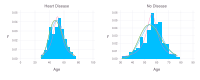

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


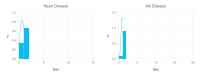

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


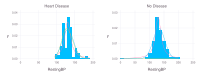

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


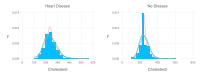

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


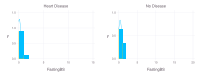

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


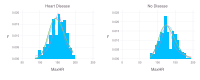

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


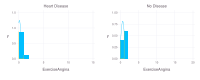

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


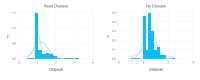

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


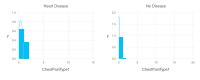

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


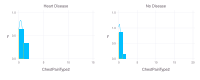

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


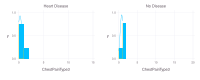

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


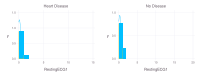

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


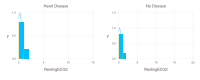

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


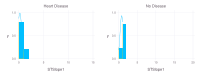

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


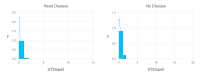

Plot(...)

┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494
┌ Warning: The following aesthetics are mapped, but not used by any geometry:
│ alpha
└ @ Gadfly C:\Users\Momo\.julia\packages\Gadfly\cqMtH\src\Gadfly.jl:494


In [312]:
for property in propertynames(select(train, Not([:ID, :HeartDisease])))
    viewVariableDistribution(train, property)
end

D'après les distributions obtenues, voici ce que nous avons choisi pour chaque variable aléatoire:

In [313]:
variable_distribution_map = Dict(
    :Age => [Normal{Float64}, Normal{Float64}],
    :Sex => [Bernoulli{Float64}, Bernoulli{Float64}],
    :RestingBP => [Normal{Float64}, Normal{Float64}],
    :Cholesterol => [Cauchy{Float64}, Cauchy{Float64}],
    :FastingBS => [Normal{Float64}, Normal{Float64}],
    :MaxHR => [Normal{Float64}, Normal{Float64}],
    :ExerciseAngina => [Bernoulli{Float64}, Bernoulli{Float64}],
    :Oldpeak => [Normal{Float64}, Normal{Float64}],
    :ChestPainType1 => [Bernoulli{Float64}, Bernoulli{Float64}],
    :ChestPainType2 => [Bernoulli{Float64}, Bernoulli{Float64}],
    :ChestPainType3 => [Bernoulli{Float64}, Bernoulli{Float64}],
    :RestingECG1 => [Bernoulli{Float64}, Bernoulli{Float64}],
    :RestingECG2 => [Bernoulli{Float64}, Bernoulli{Float64}],
    :STSlope1 => [Bernoulli{Float64}, Bernoulli{Float64}],
    :STSlope2 => [Bernoulli{Float64}, Bernoulli{Float64}],
)

Dict{Symbol, Vector{DataType}} with 15 entries:
  :STSlope1       => [Bernoulli{Float64}, Bernoulli{Float64}]
  :RestingECG2    => [Bernoulli{Float64}, Bernoulli{Float64}]
  :ChestPainType3 => [Bernoulli{Float64}, Bernoulli{Float64}]
  :Oldpeak        => [Normal{Float64}, Normal{Float64}]
  :Sex            => [Bernoulli{Float64}, Bernoulli{Float64}]
  :RestingECG1    => [Bernoulli{Float64}, Bernoulli{Float64}]
  :STSlope2       => [Bernoulli{Float64}, Bernoulli{Float64}]
  :Cholesterol    => [Cauchy{Float64}, Cauchy{Float64}]
  :ChestPainType1 => [Bernoulli{Float64}, Bernoulli{Float64}]
  :Age            => [Normal{Float64}, Normal{Float64}]
  :FastingBS      => [Normal{Float64}, Normal{Float64}]
  :MaxHR          => [Normal{Float64}, Normal{Float64}]
  :RestingBP      => [Normal{Float64}, Normal{Float64}]
  :ExerciseAngina => [Bernoulli{Float64}, Bernoulli{Float64}]
  :ChestPainType2 => [Bernoulli{Float64}, Bernoulli{Float64}]

**Section 4.3.2 Entraînement du modèle de classification bayésienne naïve**



Nous avon décidé de poser α et β = 1 vu qu'on a pas assez d'information alors nous usons d'une loi a priori vague qui est de la forme uniforme ou les paramètre sont equiprobables

In [314]:
HEART_DESEASE_POSITIVE = filter(row -> row.HeartDisease != 0, data)
HEART_DESEASE_NEGATIVE = filter(row -> row.HeartDisease == 0, data)

n₁ = size(HEART_DESEASE_POSITIVE, 1)
n₀ = size(HEART_DESEASE_NEGATIVE, 1)
n = n₁ + n₀

#Les probabilités marginales
α = 1
β = 1
p₀ = (β + n₀)/(α + β + n)
p₁ = (α + n₁)/(α + β + n)

0.5420289855072464

In [315]:
function setDistributions(dataframe::DataFrame, distribution_types::Dict)
    distributions = Dict()
    for propertyname in setdiff(propertynames(dataframe), [:ID, :HeartDisease])
        distribution_pair = []
        for i = 0:1
            y_disease =  dataframe.HeartDisease .== i
            x_ip = dataframe[y_disease, propertyname]
            fip_distribution = fit(distribution_types[propertyname][i + 1], x_ip)
            push!(distribution_pair, fip_distribution)
        end
        distributions[propertyname] = distribution_pair
    end
    return distributions
end

setDistributions (generic function with 1 method)

La fonction `train_bayes_naive_model` permet d'entraîner le model boyésienne naïve en prennant les donner à entraîner et les distributions associées `variable_distribution_map` à chaque variable aléatoire que nous avons chosis dans la section `4.3.1`.

Cette fonction retourne une liste de probabilités des `HeartDisease` que nous allons utiliser pour trouver le seuil de prédiction pour ce modèle avec les données `valid` pour évaluer notre score de prédiction.

In [316]:
function train_bayes_naive_model(dataframe::DataFrame, distribution_types::Dict)    

    function heartDiseaseProbability(variables::DataFrameRow)
        distributions = setDistributions(dataframe, distribution_types)

        (q₀, q₁) = (log(p₀), log(p₁))

        for propertyname in setdiff(propertynames(dataframe), [:ID, :HeartDisease])
            f₀ₚ(x::Real) = pdf(distributions[propertyname][1], x)
            f₁ₚ(x::Real) = pdf(distributions[propertyname][2], x)
            q₀ += log(f₀ₚ(variables[propertyname]))
            q₁ += log(f₁ₚ(variables[propertyname]))
        end
        p0 = exp.(q₀)
        p1 = exp.(q₁)
        
        # P(Ỹ = 1 | X̃ = x̃):
        # Probabilité prédictive que qu'il y a une maladie cardiaque sachant nos données
        probability = p1 / (p0 + p1)
        
        return probability
    end
    return heartDiseaseProbability
end

train_bayes_naive_model (generic function with 1 method)

### 5 Fonctions de prédiction pour les modèles

5.1 Fonction de prédiction du modèle de régression logistique

In [317]:
function train_logistic_model(dataframe::DataFrame)    
    variables = propertynames(select(dataframe, Not([:ID, :HeartDisease])))
    # Essayez avec l'aire sous la courbe
    # best_formula = forwardStepwiseRegressionAUC(dataframe, variables)
    # Nous avons choisi cette fonction, car on retrouvais un meilleur score.
    best_formula = forwardStepwiseRegressionThreshold(dataframe, variables)
    return best_formula
end

train_logistic_model (generic function with 1 method)

5.2 Fonction de prédiction du modèle de régression logistique sur une sélection de composantes principales

5.3 Fonction de prédiction du modèle de classification bayésienne naïve 

In [318]:
function predict_disease_from_bayes_naive_classifier(classify, dataframe::DataFrame)
    probabilities = Float64[]
    for row in eachrow(select(dataframe, Not([:ID, :HeartDisease])))
        push!(probabilities, classify(row))
    end
    return probabilities
end

predict_disease_from_bayes_naive_classifier (generic function with 1 method)

### 6 Choix et entraînement du modèle

6.1 Entraînement du modèle et choix de la fonction de prédiction

6.1.1 Détection des données aberrantes

In [319]:
data = CSV.read("train.csv", DataFrame)
n = nrow(data)

688

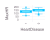

In [320]:
# Affichage des rythmes cardiques maximum en fonction de la classe

df = select(data, :MaxHR, :HeartDisease)

df.HeartDisease = string.(df.HeartDisease)

plot(df, x=:HeartDisease, y=:MaxHR, Geom.boxplot)

In [321]:
IQR = iqr(data.MaxHR)
q1 = percentile(data.MaxHR, 25)
q3 = percentile(data.MaxHR, 75)
upper_tail_MaxHR = q3 + IQR *1.5
lower_tail_MaxHR = q1 - IQR *1.5

indexes = []
for i in 1:nrow(data)
    if (data.MaxHR[i] >= upper_tail_MaxHR || data.MaxHR[i] <= lower_tail_MaxHR)
        push!(indexes, i)
    end
end
data[indexes, :]


,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String1,String3,Int64,Int64⍰,Int64,String7,Int64,String1,Float64,String7,Int64
1,109,60,M,ASY,135,missing,0,Normal,63,Y,0.5,Up,1


MaxHR contient une donnée aberrante on va donc la retirer.

In [322]:
deleterows!(data, indexes);

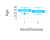

In [323]:
# Affichage des rythmes cardiques maximum en fonction de l'age

df = select(train, :Age, :HeartDisease)

df.HeartDisease = string.(df.HeartDisease)

plot(df, x=:HeartDisease, y=:Age, Geom.boxplot)

In [324]:
IQR = iqr(data.Age)
q1 = percentile(data.Age, 25)
q3 = percentile(data.Age, 75)
upper_tail_age = q3 + IQR *1.5
lower_tail_age = q1 - IQR *1.5

indexes = []
for i in 1:nrow(data)
    if (data.Age[i] >= upper_tail_age || data.Age[i] <= lower_tail_age)
        push!(indexes, i)
    end
end
data[indexes, :]

,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String1,String3,Int64,Int64⍰,Int64,String7,Int64,String1,Float64,String7,Int64


Age ne contient aucune donnée aberrante.

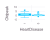

In [325]:
# Affichage des rythmes cardiques maximum en fonction de l'age

df = select(train, :Oldpeak, :HeartDisease)

df.HeartDisease = string.(df.HeartDisease)

plot(df, x=:HeartDisease, y=:Oldpeak, Geom.boxplot)

In [326]:
IQR = iqr(data.Oldpeak)
q1 = percentile(data.Oldpeak, 25)
q3 = percentile(data.Oldpeak, 75)
upper_tail_oldpeak = q3 + IQR *1.5
lower_tail_oldpeak = q1 - IQR *1.5

indexes = []
for i in 1:nrow(data)
    if (data.Oldpeak[i] >= upper_tail_oldpeak || data.Oldpeak[i] <= lower_tail_oldpeak)
        push!(indexes, i)
    end
end
data[indexes, :]

,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String1,String3,Int64,Int64⍰,Int64,String7,Int64,String1,Float64,String7,Int64
1,88,62,F,ASY,160,164,0,LVH,145,N,6.2,Down,1
2,137,58,M,ASY,114,318,0,ST,140,N,4.4,Down,1
3,171,46,M,ASY,100,missing,1,ST,133,N,-2.6,Flat,1
4,177,64,M,ASY,134,273,0,Normal,102,Y,4.0,Down,1
5,180,61,M,ASY,120,282,0,ST,135,Y,4.0,Down,1
6,291,63,M,ASY,140,187,0,LVH,144,Y,4.0,Up,1
7,318,63,F,ASY,150,407,0,LVH,154,N,4.0,Flat,1
8,432,50,M,ASY,140,231,0,ST,140,Y,5.0,Flat,1
9,543,52,M,ASY,160,246,0,ST,82,Y,4.0,Flat,1


Oldpeak contient plusieurs donnée aberrante, mais ils résultent presque en une HeartDisease positif. Donc, on ne va pas les toucher.

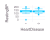

In [327]:
# Affichage des rythmes cardiques maximum en fonction de l'age

df = select(data, :RestingBP, :HeartDisease)

df.HeartDisease = string.(df.HeartDisease)

plot(df, x=:HeartDisease, y=:RestingBP, Geom.boxplot)

In [328]:
IQR = iqr(data.RestingBP)
q1 = percentile(data.RestingBP, 25)
q3 = percentile(data.RestingBP, 75)
upper_tail_resting_bp = q3 + IQR *1.5
lower_tail_resting_bp = q1 - IQR *1.5

indexes = []
for i in 1:nrow(data)
    if (data.RestingBP[i] <= lower_tail_resting_bp)
        push!(indexes, i)
    end
end
data[indexes, :]


,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String1,String3,Int64,Int64⍰,Int64,String7,Int64,String1,Float64,String7,Int64
1,238,53,M,ASY,80,missing,0,Normal,141,Y,2.0,Down,0
2,620,55,M,NAP,0,missing,0,Normal,155,N,1.5,Flat,1


RestingBP contient plusieurs données aberrantes, nous avons essayez de tous les retirés, mais cela resulte en un mauvaise score. Donc, nous avons essayez de seulement retirer les données inférieur `lower_tail_resting_bp`, car ces données semblaient les plus problématique. 

In [329]:
deleterows!(data, indexes)

,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String1,String3,Int64,Int64⍰,Int64,String7,Int64,String1,Float64,String7,Int64
1,1,69,M,ASY,140,110,1,Normal,109,Y,1.5,Flat,1
2,2,60,M,ASY,140,293,0,LVH,170,N,1.2,Flat,1
3,3,52,M,ASY,165,missing,1,Normal,122,Y,1.0,Up,1
4,4,46,M,NAP,120,230,0,Normal,150,N,0.0,Up,0
5,5,61,M,NAP,120,missing,0,Normal,80,Y,0.0,Flat,1
6,6,46,M,NAP,150,231,0,Normal,147,N,3.6,Flat,1
7,7,45,F,ATA,112,160,0,Normal,138,N,0.0,Flat,0
8,8,47,M,ASY,140,276,1,Normal,125,Y,0.0,Up,0
9,9,43,M,ASY,150,247,0,Normal,130,Y,2.0,Flat,1


In [330]:
# Affichage des rythmes cardiques maximum en fonction de l'age

df = select(data, :Cholesterol, :HeartDisease)

df.HeartDisease = string.(df.HeartDisease)

plot(df, x=:HeartDisease, y=:Cholesterol, Geom.boxplot)

Plot(...)

On ne va pas toucher aux données aberrantes pour Cholesterol non plus, car plusieurs valeurs ont été manuellement remplacées par la moyenne. 

In [331]:
# Lister toutes les modèles entraînées

# Classification régréssion logistique
replaceMissingCholesterolMean(data)
transformQualitativeVariables(data)
best_formula = train_logistic_model(data)
logistic_model = glm(best_formula, data, Bernoulli(), LogitLink())

# Classification régréssion logistique avec analyse composantes principales.

# Classification bayésienne naïve.
# bayes_naive_classified = train_bayes_naive_model(train, variable_distribution_map)

Toutes les valeurs manquantes ont été remplancées par la moyenne de la colonne Cholesterol: 244
Meilleur score est 0.6423357664233577 avec 0.56
AUC pour HeartDisease ~ Age : 0.6423357664233577
Meilleur score est 0.6423357664233577 avec 0.61
AUC pour HeartDisease ~ Sex : 0.6423357664233577
Meilleur score est 0.5547445255474452 avec 0.51
AUC pour HeartDisease ~ RestingBP : 0.5547445255474452
Meilleur score est 0.6087591240875913 avec 0.54
AUC pour HeartDisease ~ Cholesterol : 0.6087591240875913
Meilleur score est 0.5927007299270073 avec 0.77
AUC pour HeartDisease ~ FastingBS : 0.5927007299270073
Meilleur score est 0.6934306569343066 avec 0.58
AUC pour HeartDisease ~ MaxHR : 0.6934306569343066
Meilleur score est 0.7328467153284671 avec 0.84
AUC pour HeartDisease ~ ExerciseAngina : 0.7328467153284671
Meilleur score est 0.7343065693430657 avec 0.57
AUC pour HeartDisease ~ Oldpeak : 0.7343065693430657
Meilleur score est 0.6686131386861314 avec 0.62
AUC pour HeartDisease ~ ChestPainType1 : 0.


Meilleur score est 0.8759124087591241 avec 0.44
AUC pour HeartDisease ~ STSlope1 + Oldpeak + MaxHR + Sex + ExerciseAngina + FastingBS + ChestPainType3 + Age : 0.8759124087591241
Meilleur score est 0.8788321167883212 avec 0.41
AUC pour HeartDisease ~ STSlope1 + Oldpeak + MaxHR + Sex + ExerciseAngina + FastingBS + ChestPainType3 + RestingBP : 0.8788321167883212
Meilleur score est 0.8759124087591241 avec 0.42
AUC pour HeartDisease ~ STSlope1 + Oldpeak + MaxHR + Sex + ExerciseAngina + FastingBS + ChestPainType3 + Cholesterol : 0.8759124087591241
Meilleur score est 0.8802919708029197 avec 0.42
AUC pour HeartDisease ~ STSlope1 + Oldpeak + MaxHR + Sex + ExerciseAngina + FastingBS + ChestPainType3 + ChestPainType1 : 0.8802919708029197
Meilleur score est 0.8788321167883212 avec 0.41
AUC pour HeartDisease ~ STSlope1 + Oldpeak + MaxHR + Sex + ExerciseAngina + FastingBS + ChestPainType3 + ChestPainType2 : 0.8788321167883212
Meilleur score est 0.8773722627737226 avec 0.42
AUC pour HeartDisease ~ S

StatsModels.TableRegressionModel{GeneralizedLinearModel{GLM.GlmResp{Vector{Float64}, Bernoulli{Float64}, LogitLink}, GLM.DensePredChol{Float64, Cholesky{Float64, Matrix{Float64}}}}, Matrix{Float64}}

HeartDisease ~ 1 + STSlope1 + Oldpeak + MaxHR + Sex + ExerciseAngina + FastingBS + ChestPainType3 + ChestPainType1 + RestingBP

Coefficients:
──────────────────────────────────────────────────────────────────────────────────
                      Coef.  Std. Error      z  Pr(>|z|)   Lower 95%     Upper 95%
──────────────────────────────────────────────────────────────────────────────────
(Intercept)     -2.41069     1.28037     -1.88    0.0597  -4.92017     0.0987836
STSlope1         2.21861     0.253846     8.74    <1e-17   1.72108     2.71614
Oldpeak          0.610239    0.118879     5.13    <1e-06   0.377241    0.843237
MaxHR           -0.0107162   0.00513349  -2.09    0.0368  -0.0207776  -0.000654726
Sex              1.60846     0.319115     5.04    <1e-06   0.983003    2.23391
Exercis

6.2 Optimisation du seuil

In [332]:
function findBestThreshold(θ̂::Array, dataframe::DataFrame)
    function evaluateScore(prediction::DataFrame)
        count = 0;
        for i = 1:nrow(prediction)
            if (prediction[i, 2] == dataframe.HeartDisease[i])
                count += 1;
            end 
        end
    
        return count / nrow(prediction)
    end
    maxScore = 0;
    best_threshold = 0;
    for threshold in 0.1:0.01:0.9
        ŷ = Int64[]
        index = 0;
        for θ̂ᵢ in θ̂
            if θ̂ᵢ >= threshold
                push!(ŷ, 1)
            else
                push!(ŷ, 0)
            end
        end
        prediction = DataFrame(ID = dataframe.ID, Prediction = ŷ)
        score = evaluateScore(prediction)
        if (score >= maxScore)
            maxScore = score
            best_threshold = threshold
        end
    end

    println("Meilleur score est ", maxScore, " avec ", best_threshold)
    return best_threshold
end

findBestThreshold (generic function with 2 methods)

6.2.1 Optimisation du seuil du modèle de régression logistique

Pour trouver le seuil de .31 nous avons séparer nos données d'entrainement fourni en une autre ensemble de données d'entrainement et de validation. Le code pour ca a été mise en commentaire.

In [333]:
countmap(data.HeartDisease)
# max_amount_positif = 236
# max_amount_negatif = 236

Dict{Int64, Int64} with 2 entries:
  0 => 314
  1 => 371

In [334]:
# train_data_indexes = Array{Int}(undef, 0)
# amount_positif = 0
# amount_negatif = 0

# for i in 1:nrow(data)
#     if(data[i, :].HeartDisease == 1 && amount_positif < max_amount_positif)
#         amount_positif = amount_positif + 1
#         push!(train_data_indexes, i)
#     elseif (data[i, :].HeartDisease == 0 && amount_negatif < max_amount_negatif)
#         amount_negatif = amount_negatif + 1
#         push!(train_data_indexes, i)
#     end
# end

# valid_id = setdiff(1:nrow(data), train_data_indexes)

# train_data = data[train_data_indexes, :]
# test_data = data[valid_id, :]

# CSV.write("train1.csv", train_data)
# CSV.write("test1.csv", test_data)

Par la suite, on a cherche le meilleur score obtenu en essayant avec des seuil entre 0.1 et 0.9. Le meilleur était 0.31 pour la régression logistic. 

In [335]:
test = CSV.read("test.csv", DataFrame);
replaceMissingCholesterolMean(test)
transformQualitativeVariables(test)
n = nrow(test)

θ̂ = predict(logistic_model, test)

ŷ = Int64[]
index = 0;
for θ̂ᵢ in θ̂
    if θ̂ᵢ >= .31
        push!(ŷ, 1)
    else
        push!(ŷ, 0)
    end
end

prediction = DataFrame(ID = test.ID, Prediction = ŷ)

CSV.write("benchmark_predictions.csv", prediction)
correctrate(test.HeartDisease, prediction.Prediction)

Toutes les valeurs manquantes ont été remplancées par la moyenne de la colonne Cholesterol: 243


LoadError: ArgumentError: column name :HeartDisease not found in the data frame

6.2.2 Optimisation du seuil du modèle de régression logistique avec composantes principales

6.2.3 Optimisation du seuil du modèle de classification bayésienne naïne

In [336]:
θ̂_bayes_naive = predict_disease_from_bayes_naive_classifier(bayes_naive_classified, valid)
threshold_bayes_naive = findBestThreshold(θ̂_bayes_naive, valid)

Meilleur score est 0.9057971014492754 avec 0.71


0.71

6.3 Évaluation de la qualité des prédictions

6.4 Autres améliorations globales

### 7. Prédiction des tumeurs malignes de l'ensemble de test